In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.metrics import mean_squared_error

from prophet import Prophet
from prophet.plot import plot_components_plotly, plot_plotly

import warnings
warnings.filterwarnings("ignore")

In [3]:
df = pd.read_excel("Wind Turbine Power Generation.xlsx")

In [4]:
df.head()

,Unnamed: 0,Time,Location,Temp_2m,RelHum_2m,DP_2m,WS_10m,WS_100m,WD_10m,WD_100m,WG_10m,Power
0,0,2013-01-02 00:00:00,1,28.2796,84.664205,24.072595,1.605389,1.267799,145.051683,161.057315,1.336515,0.163496
1,1,2013-01-02 01:00:00,1,28.1796,85.664205,24.272595,2.225389,3.997799,150.051683,157.057315,4.336515,0.142396
2,2,2013-01-02 02:00:00,1,26.5796,90.664205,24.072595,1.465389,2.787799,147.051683,149.057315,3.136515,0.121396
3,3,2013-01-02 03:00:00,1,27.1796,87.664205,23.872595,1.465389,2.697799,57.051683,104.057315,1.536515,0.100296
4,4,2013-01-02 04:00:00,1,27.0796,87.664205,23.672595,2.635389,4.437799,57.051683,83.057315,3.936515,0.079296


In [5]:
df.drop("Unnamed: 0", axis=1, inplace=True)

In [6]:
df["Location"].unique()

array([1, 2, 3, 4], dtype=int64)

In [7]:
loc1 = df[df["Location"]==1][["Time", "Power"]]
loc2 = df[df["Location"]==2][["Time", "Power"]]
loc3 = df[df["Location"]==3][["Time", "Power"]]
loc4 = df[df["Location"]==4][["Time", "Power"]]

In [8]:
loc1

,Time,Power
0,2013-01-02 00:00:00,0.163496
1,2013-01-02 01:00:00,0.142396
2,2013-01-02 02:00:00,0.121396
3,2013-01-02 03:00:00,0.100296
4,2013-01-02 04:00:00,0.079296
...,...,...
35035,2016-12-31 19:00:00,0.204796
35036,2016-12-31 20:00:00,0.197196
35037,2016-12-31 21:00:00,0.189596
35038,2016-12-31 22:00:00,0.181996


In [9]:
loc2

,Time,Power
35040,2013-01-02 00:00:00,0.257396
35041,2013-01-02 01:00:00,0.253496
35042,2013-01-02 02:00:00,0.249696
35043,2013-01-02 03:00:00,0.245796
35044,2013-01-02 04:00:00,0.241896
...,...,...
70075,2016-12-31 19:00:00,0.309496
70076,2016-12-31 20:00:00,0.307496
70077,2016-12-31 21:00:00,0.305496
70078,2016-12-31 22:00:00,0.303496


In [10]:
loc3

,Time,Power
70080,2013-01-02 00:00:00,0.343796
70081,2013-01-02 01:00:00,0.395396
70082,2013-01-02 02:00:00,0.447096
70083,2013-01-02 03:00:00,0.498796
70084,2013-01-02 04:00:00,0.550396
...,...,...
105115,2016-12-31 19:00:00,0.161896
105116,2016-12-31 20:00:00,0.144896
105117,2016-12-31 21:00:00,0.127796
105118,2016-12-31 22:00:00,0.110796


In [11]:
loc4

,Time,Power
105120,2013-01-02 00:00:00,0.304696
105121,2013-01-02 01:00:00,0.351596
105122,2013-01-02 02:00:00,0.398496
105123,2013-01-02 03:00:00,0.445396
105124,2013-01-02 04:00:00,0.492196
...,...,...
140155,2016-12-31 19:00:00,0.288196
140156,2016-12-31 20:00:00,0.257896
140157,2016-12-31 21:00:00,0.227496
140158,2016-12-31 22:00:00,0.197196


In [12]:
loc1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 35040 entries, 0 to 35039
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Time    35040 non-null  datetime64[ns]
 1   Power   35040 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 821.2 KB


In [13]:
avg_power = loc1["Power"].mean()

In [14]:
avg_power

0.4054035944481564

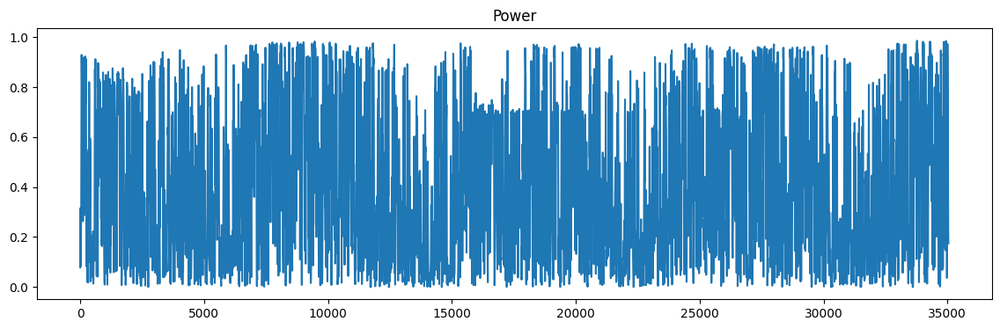

In [18]:
loc1["Power"].plot(figsize=(14, 4), title="Power")
plt.show()

In [29]:
loc1.columns = ["ds", "y"]

In [30]:
loc1.head()

,ds,y
0,2013-01-02 00:00:00,0.163496
1,2013-01-02 01:00:00,0.142396
2,2013-01-02 02:00:00,0.121396
3,2013-01-02 03:00:00,0.100296
4,2013-01-02 04:00:00,0.079296


In [32]:
train = loc1.iloc[:len(loc1)-168]
test = loc1.iloc[len(loc1)-168:]

In [33]:
train.shape

(34872, 2)

In [34]:
test.shape

(168, 2)

In [35]:
model = Prophet()

In [36]:
model.fit(train)

19:04:50 - cmdstanpy - INFO - Chain [1] start processing
19:04:58 - cmdstanpy - INFO - Chain [1] done processing


In [37]:
train.tail()

,ds,y
34867,2016-12-24 19:00:00,0.231996
34868,2016-12-24 20:00:00,0.308996
34869,2016-12-24 21:00:00,0.385996
34870,2016-12-24 22:00:00,0.462996
34871,2016-12-24 23:00:00,0.539996


In [38]:
future_time = model.make_future_dataframe(periods=168, freq="h")

In [39]:
future_time

,ds
0,2013-01-02 00:00:00
1,2013-01-02 01:00:00
2,2013-01-02 02:00:00
3,2013-01-02 03:00:00
4,2013-01-02 04:00:00
...,...
35035,2016-12-31 19:00:00
35036,2016-12-31 20:00:00
35037,2016-12-31 21:00:00
35038,2016-12-31 22:00:00


In [41]:
forecast = model.predict(future_time)

In [42]:
forecast.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2013-01-02 00:00:00,0.355377,0.137436,0.817149,0.355377,0.355377,0.129979,0.129979,0.129979,0.008696,0.008696,0.008696,-0.004914,-0.004914,-0.004914,0.126197,0.126197,0.126197,0.0,0.0,0.0,0.485356
1,2013-01-02 01:00:00,0.355392,0.130034,0.832204,0.355392,0.355392,0.134815,0.134815,0.134815,0.014269,0.014269,0.014269,-0.005829,-0.005829,-0.005829,0.126375,0.126375,0.126375,0.0,0.0,0.0,0.490207
2,2013-01-02 02:00:00,0.355408,0.178604,0.866300,0.355408,0.355408,0.140561,0.140561,0.140561,0.020763,0.020763,0.020763,-0.006753,-0.006753,-0.006753,0.126551,0.126551,0.126551,0.0,0.0,0.0,0.495969
3,2013-01-02 03:00:00,0.355423,0.178203,0.842287,0.355423,0.355423,0.145596,0.145596,0.145596,0.026541,0.026541,0.026541,-0.007669,-0.007669,-0.007669,0.126725,0.126725,0.126725,0.0,0.0,0.0,0.501019
4,2013-01-02 04:00:00,0.355439,0.181962,0.847736,0.355439,0.355439,0.147864,0.147864,0.147864,0.029531,0.029531,0.029531,-0.008565,-0.008565,-0.008565,0.126897,0.126897,0.126897,0.0,0.0,0.0,0.503302


In [43]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
35035,2016-12-31 19:00:00,0.425355,0.187668,0.867166,0.425355,0.425355,0.109000,0.109000,0.109000,-0.017952,-0.017952,-0.017952,0.006643,0.006643,0.006643,0.120309,0.120309,0.120309,0.0,0.0,0.0,0.534355
35036,2016-12-31 20:00:00,0.425359,0.176348,0.873376,0.425359,0.425359,0.115190,0.115190,0.115190,-0.011970,-0.011970,-0.011970,0.006625,0.006625,0.006625,0.120535,0.120535,0.120535,0.0,0.0,0.0,0.540549
35037,2016-12-31 21:00:00,0.425363,0.214225,0.887609,0.425363,0.425363,0.121717,0.121717,0.121717,-0.005585,-0.005585,-0.005585,0.006543,0.006543,0.006543,0.120760,0.120760,0.120760,0.0,0.0,0.0,0.547080
35038,2016-12-31 22:00:00,0.425367,0.191315,0.901393,0.425367,0.425367,0.127214,0.127214,0.127214,-0.000158,-0.000158,-0.000158,0.006389,0.006389,0.006389,0.120983,0.120983,0.120983,0.0,0.0,0.0,0.552581
35039,2016-12-31 23:00:00,0.425370,0.230331,0.896704,0.425370,0.425370,0.131600,0.131600,0.131600,0.004239,0.004239,0.004239,0.006157,0.006157,0.006157,0.121204,0.121204,0.121204,0.0,0.0,0.0,0.556970


In [44]:
forecast[["ds", "yhat", "yhat_lower", "yhat_upper"]]

,ds,yhat,yhat_lower,yhat_upper
0,2013-01-02 00:00:00,0.485356,0.137436,0.817149
1,2013-01-02 01:00:00,0.490207,0.130034,0.832204
2,2013-01-02 02:00:00,0.495969,0.178604,0.866300
3,2013-01-02 03:00:00,0.501019,0.178203,0.842287
4,2013-01-02 04:00:00,0.503302,0.181962,0.847736
...,...,...,...,...
35035,2016-12-31 19:00:00,0.534355,0.187668,0.867166
35036,2016-12-31 20:00:00,0.540549,0.176348,0.873376
35037,2016-12-31 21:00:00,0.547080,0.214225,0.887609
35038,2016-12-31 22:00:00,0.552581,0.191315,0.901393


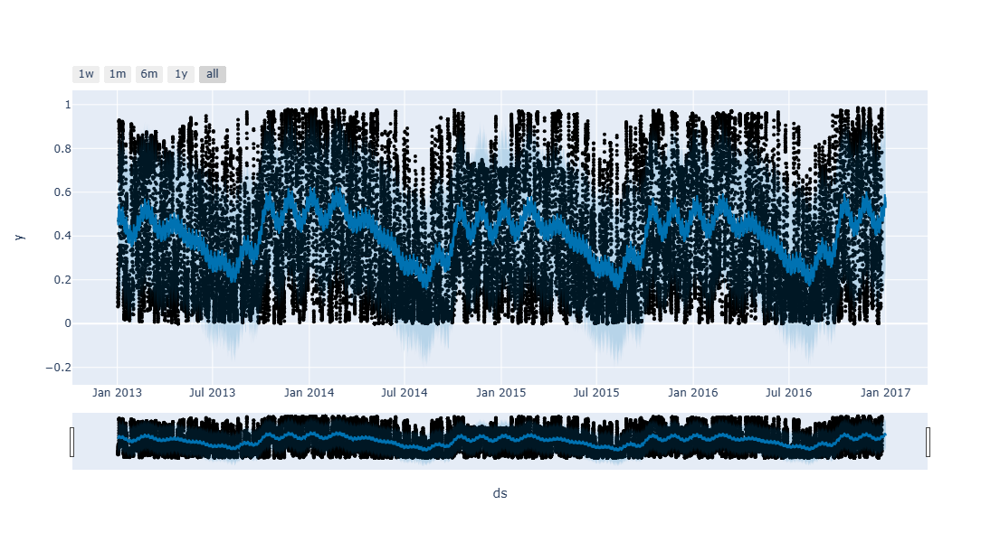

In [45]:
plot_plotly(model, forecast)

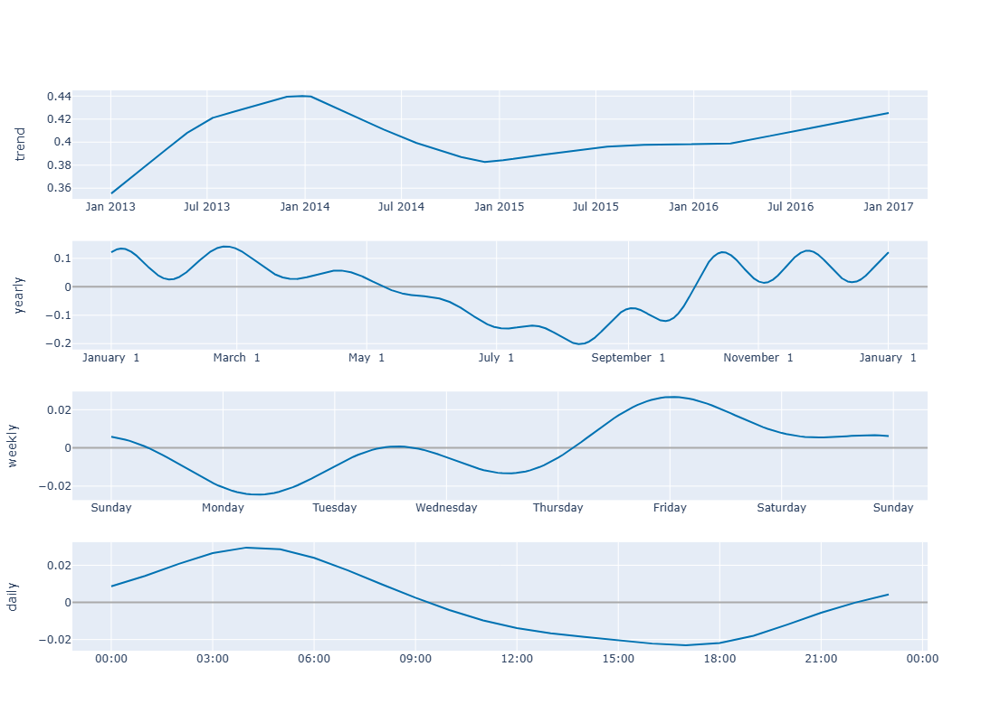

In [46]:
plot_components_plotly(model, forecast)

In [47]:
pred = forecast.iloc[-168:]["yhat"]

In [48]:
pred

34872    0.508479
34873    0.514001
34874    0.520350
34875    0.525888
34876    0.528542
           ...   
35035    0.534355
35036    0.540549
35037    0.547080
35038    0.552581
35039    0.556970
Name: yhat, Length: 168, dtype: float64

In [49]:
rmse = np.sqrt(mean_squared_error(test["y"], pred))

In [50]:
rmse

0.28745384068124963

In [51]:
test["y"].mean()

0.622845886114823

In [52]:
loc1.head()

,ds,y
0,2013-01-02 00:00:00,0.163496
1,2013-01-02 01:00:00,0.142396
2,2013-01-02 02:00:00,0.121396
3,2013-01-02 03:00:00,0.100296
4,2013-01-02 04:00:00,0.079296


In [59]:
a, b = loc1.iloc[:24].mean()

In [60]:
a, b

(Timestamp('2013-01-02 11:30:00'), 0.194145886114823)

In [57]:
len(loc1)/24

1460.0

In [61]:
new_power = []
new_date = []
start = 0
end = 24
while end<=35040:
    a, b = loc1.iloc[start:end].mean()
    new_date.append(a)
    new_power.append(b)
    start = end
    end = end+24

In [64]:
new_power = np.array(new_power)

In [65]:
new_date = np.array(new_date)

In [66]:
df = pd.DataFrame({"ds":new_date, "y":new_power})

In [67]:
df.head()

,ds,y
0,2013-01-02 11:30:00,0.194146
1,2013-01-03 11:30:00,0.230354
2,2013-01-04 11:30:00,0.868029
3,2013-01-05 11:30:00,0.698038
4,2013-01-06 11:30:00,0.322767


In [68]:
df.tail()

,ds,y
1455,2016-12-27 11:30:00,0.612208
1456,2016-12-28 11:30:00,0.795583
1457,2016-12-29 11:30:00,0.335638
1458,2016-12-30 11:30:00,0.901246
1459,2016-12-31 11:30:00,0.403550


In [85]:
df["ds"] = pd.date_range(start="2013-01-02", end="2016-12-31")

In [86]:
df.head()

,ds,y
0,2013-01-02,0.194146
1,2013-01-03,0.230354
2,2013-01-04,0.868029
3,2013-01-05,0.698038
4,2013-01-06,0.322767


In [101]:
df.tail()

,ds,y
1455,2016-12-27,0.612208
1456,2016-12-28,0.795583
1457,2016-12-29,0.335638
1458,2016-12-30,0.901246
1459,2016-12-31,0.403550


In [87]:
train = df.iloc[:len(df)-365]
test = df.iloc[len(df)-365:]

In [102]:
train.shape

(1095, 2)

In [103]:
test.shape

(365, 2)

In [88]:
model2 = Prophet()

In [89]:
model2.fit(train)

19:47:57 - cmdstanpy - INFO - Chain [1] start processing
19:47:57 - cmdstanpy - INFO - Chain [1] done processing


In [107]:
future_date = model2.make_future_dataframe(periods=365, freq="D")

In [108]:
future_date

,ds
0,2013-01-02
1,2013-01-03
2,2013-01-04
3,2013-01-05
4,2013-01-06
...,...
1455,2016-12-27
1456,2016-12-28
1457,2016-12-29
1458,2016-12-30


In [109]:
forecast2 = model2.predict(future_date)

In [110]:
forecast2.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
1455,2016-12-27,0.399205,0.184901,0.740301,0.395324,0.403169,0.065637,0.065637,0.065637,-0.021820,-0.021820,-0.021820,0.087456,0.087456,0.087456,0.0,0.0,0.0,0.464842
1456,2016-12-28,0.399196,0.220403,0.785244,0.395296,0.403183,0.104231,0.104231,0.104231,0.008557,0.008557,0.008557,0.095674,0.095674,0.095674,0.0,0.0,0.0,0.503428
1457,2016-12-29,0.399187,0.222066,0.801247,0.395267,0.403192,0.109655,0.109655,0.109655,0.006227,0.006227,0.006227,0.103427,0.103427,0.103427,0.0,0.0,0.0,0.508842
1458,2016-12-30,0.399178,0.250699,0.803361,0.395238,0.403202,0.129033,0.129033,0.129033,0.018468,0.018468,0.018468,0.110564,0.110564,0.110564,0.0,0.0,0.0,0.528211
1459,2016-12-31,0.399169,0.230586,0.819022,0.395209,0.403217,0.129848,0.129848,0.129848,0.012899,0.012899,0.012899,0.116949,0.116949,0.116949,0.0,0.0,0.0,0.529017


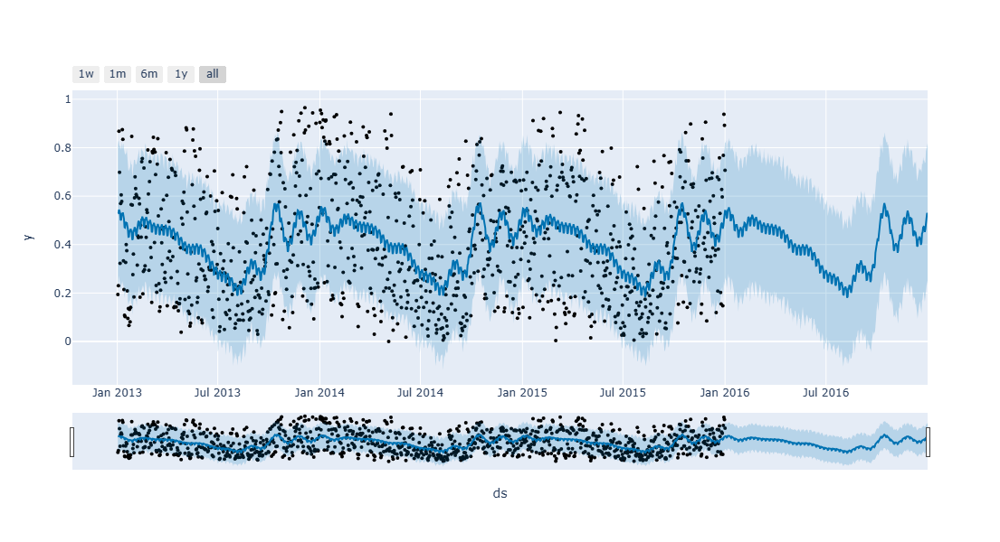

In [111]:
plot_plotly(model2, forecast2)

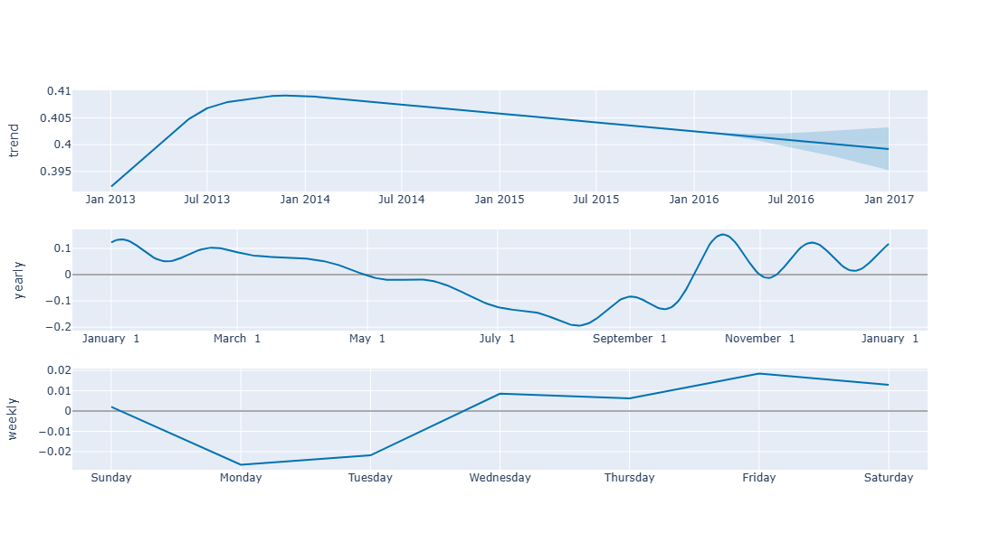

In [112]:
plot_components_plotly(model2, forecast2)

In [113]:
pred2 = forecast2.iloc[-365:]["yhat"]

In [114]:
pred2

1095    0.539075
1096    0.532568
1097    0.507282
1098    0.514052
1099    0.545485
          ...   
1455    0.464842
1456    0.503428
1457    0.508842
1458    0.528211
1459    0.529017
Name: yhat, Length: 365, dtype: float64

In [115]:
rmse2 = np.sqrt(mean_squared_error(pred2, test["y"]))

In [116]:
rmse2

0.22491760948599337

In [117]:
test["y"].mean()

0.40564638839792805